In [2]:
# import the modules
import urllib.request
import networkx as nx
import numpy as np
import random
import matplotlib.pyplot as plt

In [3]:
#Load the dataset
# Load the Facebook-Ego network
facebook_url = "https://raw.githubusercontent.com/wang422003/Complex-Networks_exercise/main/Datasets/Group3/Facebook-Ego/348.edges"
urllib.request.urlretrieve(facebook_url, "facebook.edges")
facebook_network = nx.read_edgelist("facebook.edges", nodetype=int)

# Load the Twitter-Ego network
twitter_url = "https://raw.githubusercontent.com/wang422003/Complex-Networks_exercise/main/Datasets/Group3/Twitter-Ego/789071.edges"
urllib.request.urlretrieve(twitter_url, "twitter.edges")
twitter_network = nx.read_edgelist("twitter.edges", nodetype=int, create_using=nx.DiGraph())


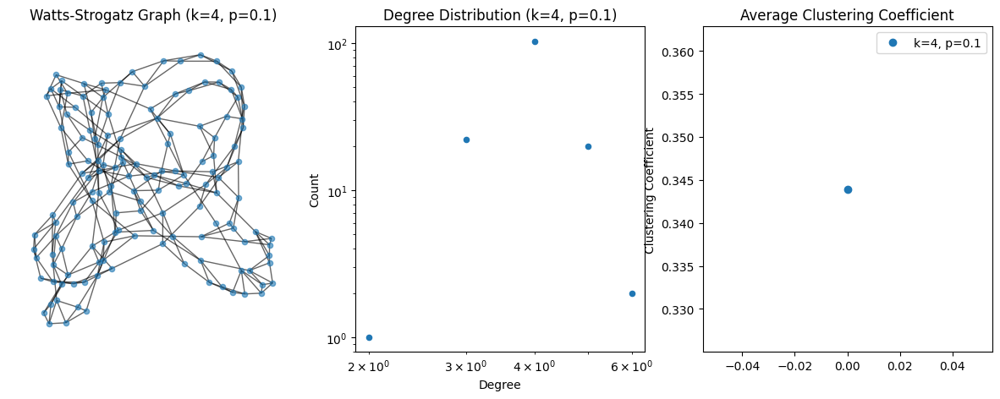

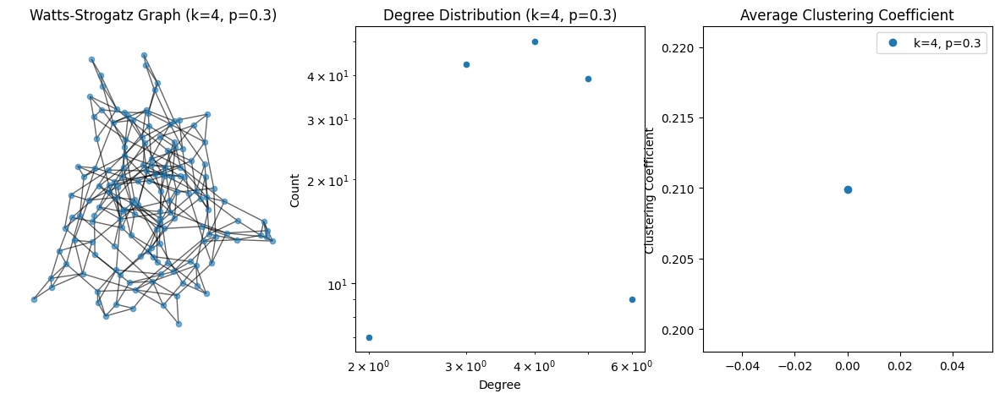

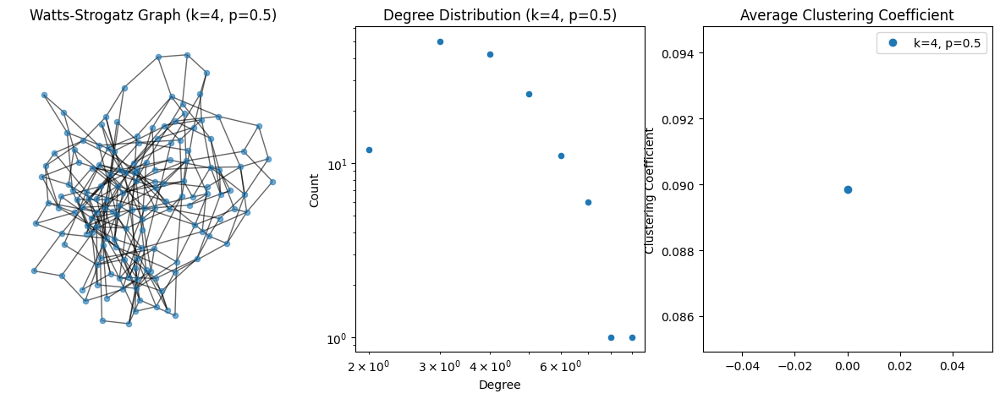

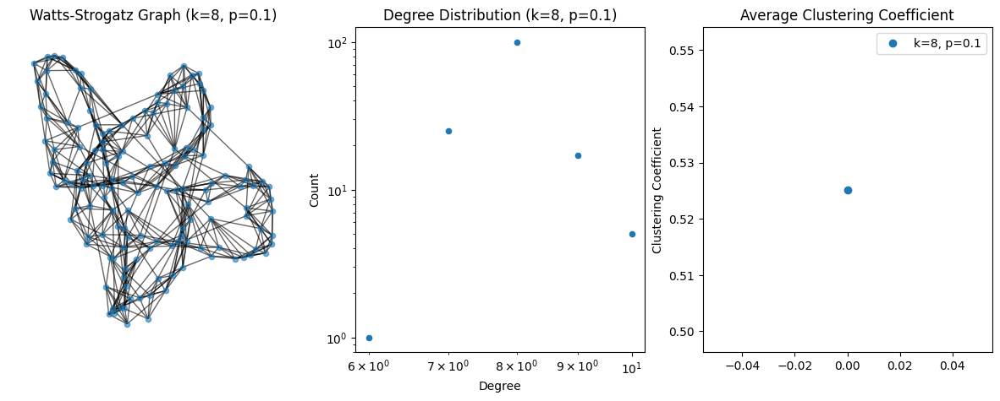

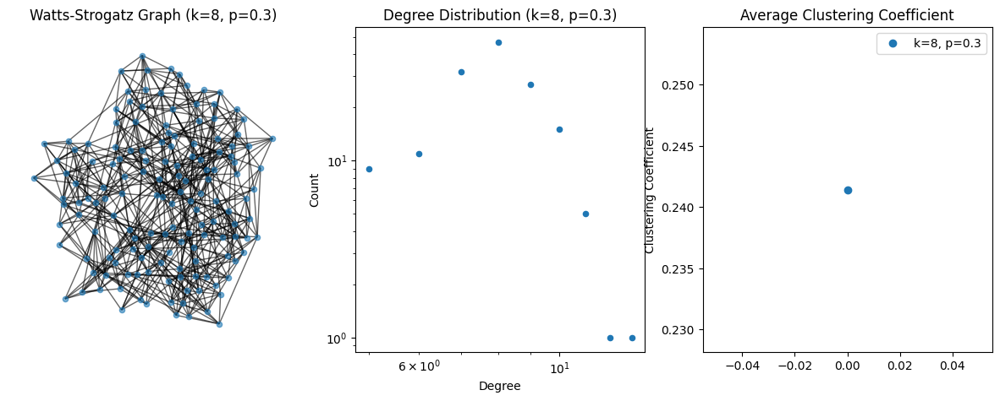

...

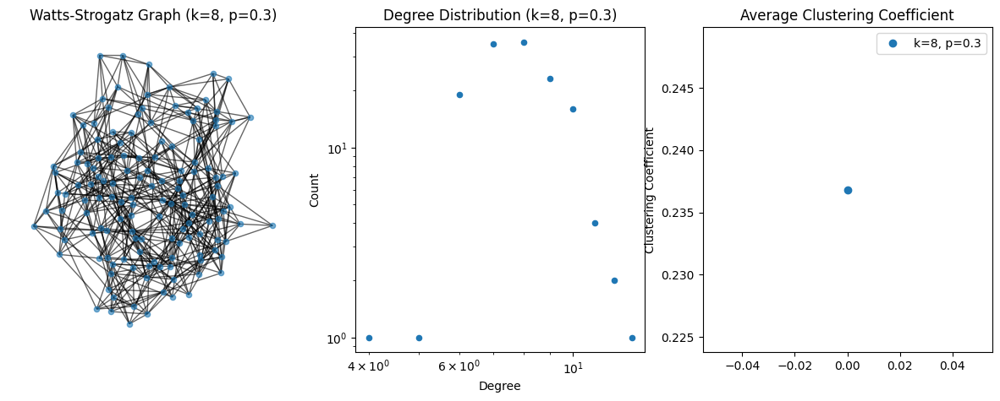

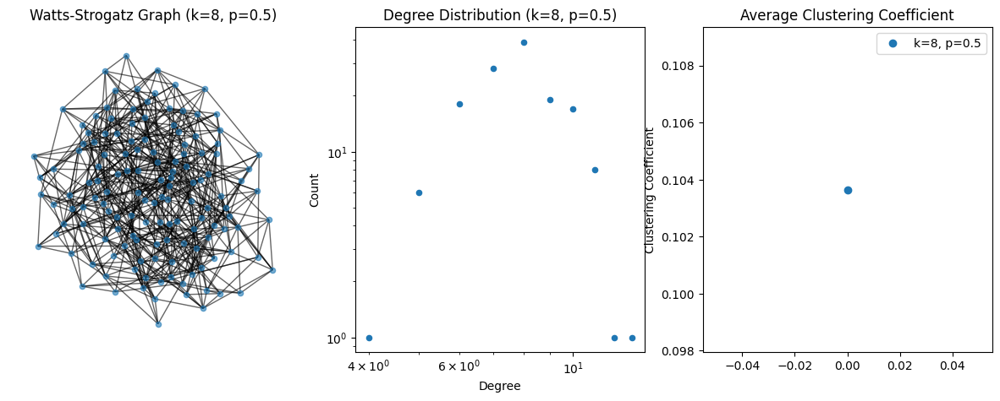

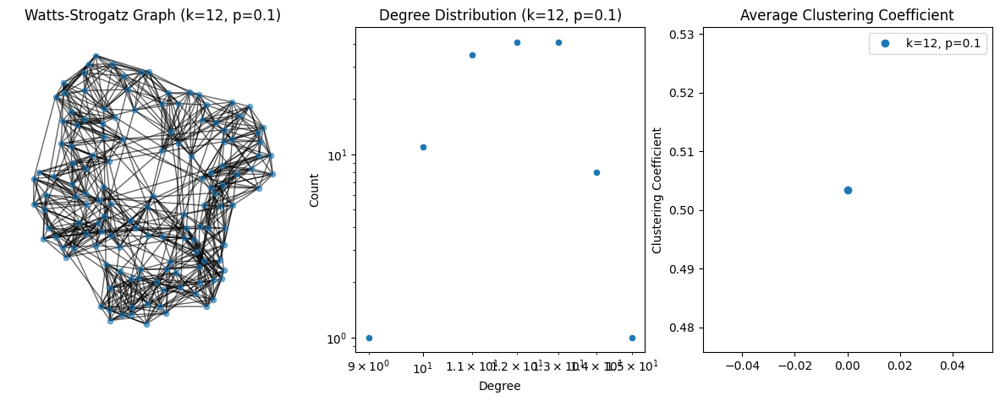

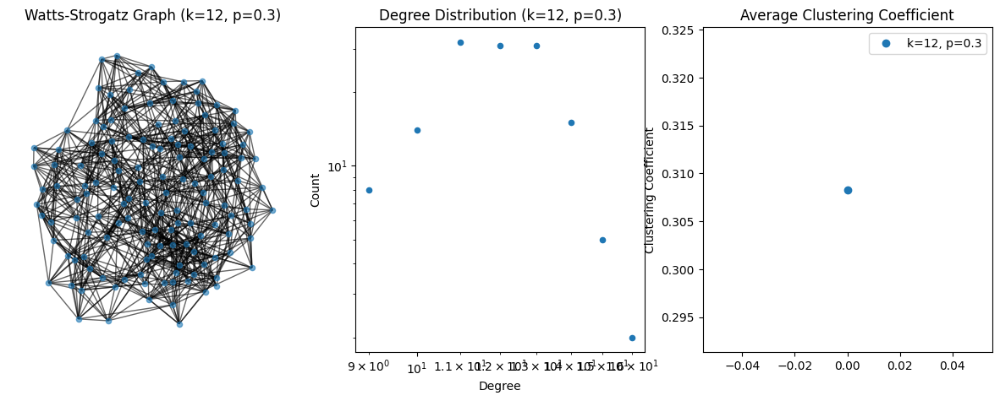

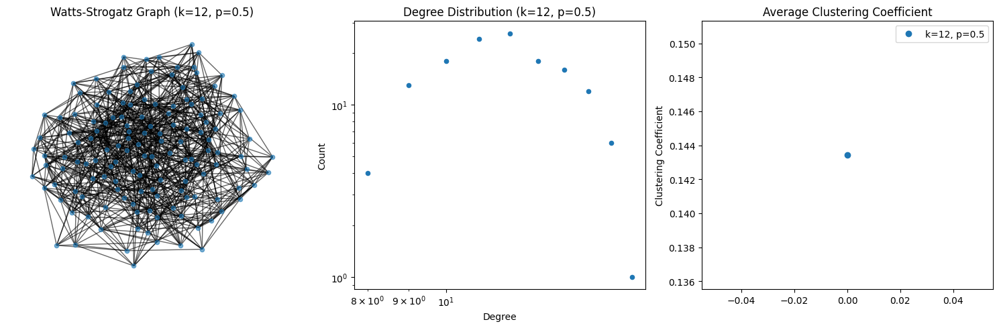

In [7]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Function to generate Watts-Strogatz graphs and plot structures
def generate_watts_strogatz_graph(num_nodes, k_values, p_values):
    for k in k_values:
        for p in p_values:
            # Generate the graph using the Watts-Strogatz model
            graph = nx.watts_strogatz_graph(num_nodes, k, p)

            # Plot the graph structure
            plt.figure(figsize=(15, 5))
            plt.subplot(131)
            nx.draw(graph, node_size=20, with_labels=False, font_size=8, alpha=0.6)
            plt.title(f"Watts-Strogatz Graph (k={k}, p={p})", fontsize=12)

           
            # Plot the degree distribution
            plt.subplot(132)
            degree_sequence = [d for n, d in graph.degree()]
            degree_count = np.array(np.unique(degree_sequence, return_counts=True)).T
            plt.scatter(degree_count[:, 0], degree_count[:, 1], s=20)
            plt.title(f"Degree Distribution (k={k}, p={p})", fontsize=12)
            plt.xscale('log')
            plt.yscale('log')
            plt.xlabel("Degree", fontsize=10)
            plt.ylabel("Count", fontsize=10)

            # Plot a single point for the clustering coefficient
            plt.subplot(133)
            clustering_coefficient = nx.average_clustering(graph)
            plt.plot([clustering_coefficient], 'o', label=f'k={k}, p={p}')
            plt.title("Average Clustering Coefficient", fontsize=12)
            plt.ylabel("Clustering Coefficient", fontsize=10)
            plt.legend()


# Set the number of nodes in each graph
facebook_n = len(facebook_network.nodes())
twitter_n = len(twitter_network.nodes())

# Generate Watts-Strogatz graphs for Facebook-Ego network
generate_watts_strogatz_graph(facebook_n, [4, 8, 12], [0.1, 0.3, 0.5])

# Generate Watts-Strogatz graphs for Twitter-Ego network
generate_watts_strogatz_graph(twitter_n, [4, 8, 12], [0.1, 0.3, 0.5])

plt.tight_layout()
plt.show()

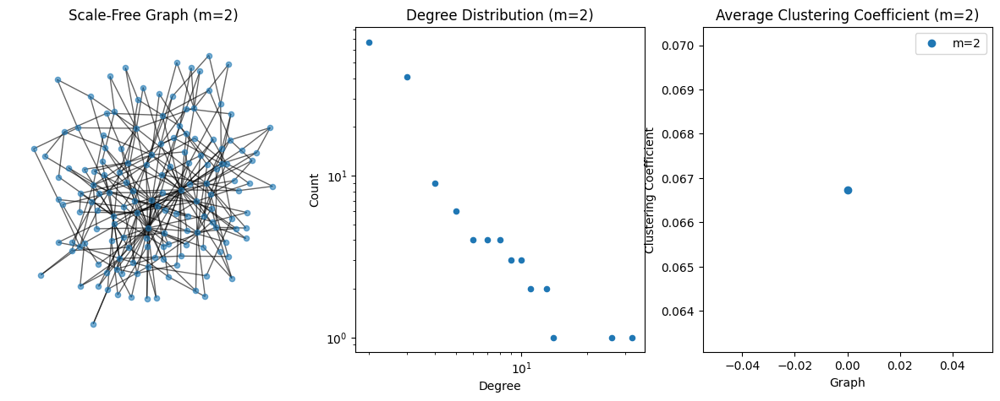

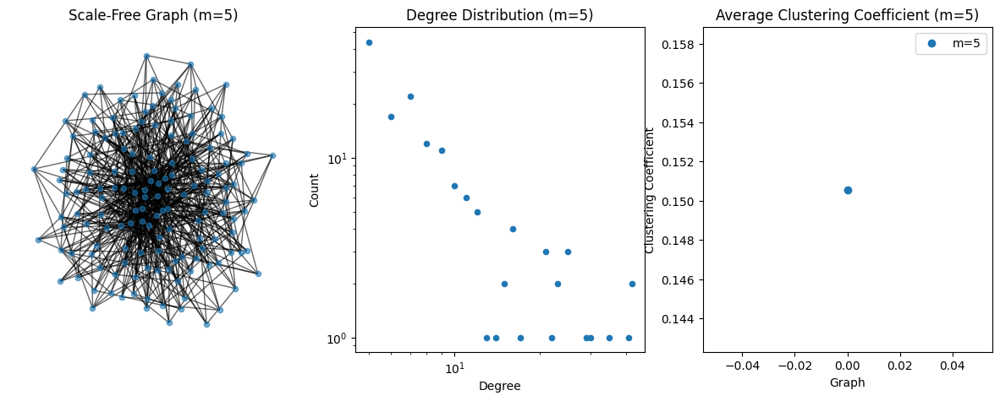

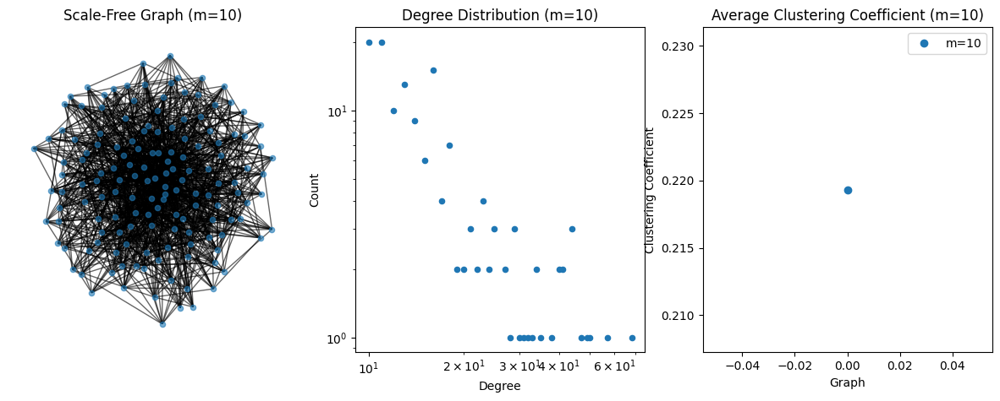

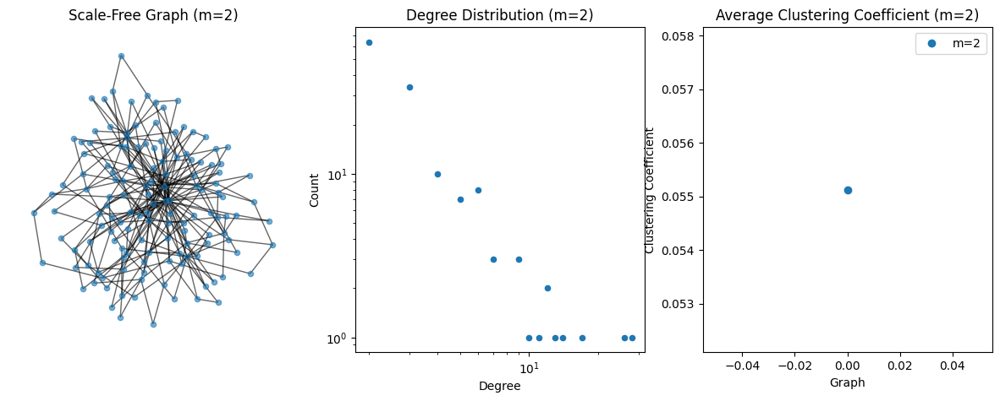

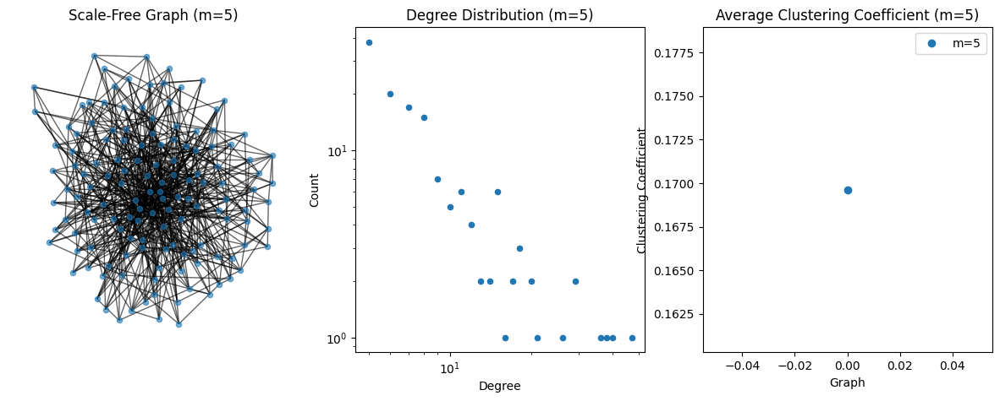

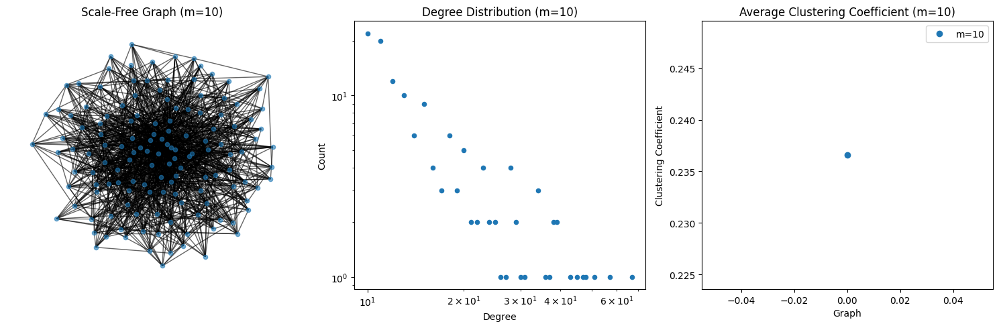

In [20]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Function to generate scale-free graphs and plot structures
def generate_scale_free_graph(num_nodes, m):
    # Generate the graph using the Barabási-Albert model
    graph = nx.barabasi_albert_graph(num_nodes, m)

    # Plot the graph structure
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    nx.draw(graph, node_size=20, with_labels=False, font_size=8, alpha=0.6)
    plt.title(f"Scale-Free Graph (m={m})", fontsize=12)

    # Plot the degree distribution
    plt.subplot(132)
    degree_sequence = sorted([d for n, d in graph.degree()], reverse=True)
    degree_count = np.array(np.unique(degree_sequence, return_counts=True)).T
    plt.scatter(degree_count[:, 0], degree_count[:, 1], s=20)
    plt.xscale('log')
    plt.yscale('log')
    plt.title(f"Degree Distribution (m={m})", fontsize=12)
    plt.xlabel("Degree", fontsize=10)
    plt.ylabel("Count", fontsize=10)

    # Plot the average clustering coefficient
    plt.subplot(133)
    avg_clustering_coefficient = nx.average_clustering(graph)
    plt.plot([avg_clustering_coefficient], 'o', label=f'm={m}')
    plt.title(f"Average Clustering Coefficient (m={m})", fontsize=12)
    plt.xlabel("Graph", fontsize=10)
    plt.ylabel("Clustering Coefficient", fontsize=10)
    plt.legend()

# Assuming you have loaded your Facebook-Ego and Twitter-Ego networks
# facebook_network = ...
# twitter_network = ...

# Set the number of nodes in each graph
facebook_n = len(facebook_network.nodes())
twitter_n = len(twitter_network.nodes())

# Generate scale-free graphs for Facebook-Ego network
generate_scale_free_graph(facebook_n, 2)
generate_scale_free_graph(facebook_n, 5)
generate_scale_free_graph(facebook_n, 10)

# Generate scale-free graphs for Twitter-Ego network
generate_scale_free_graph(twitter_n, 2)
generate_scale_free_graph(twitter_n, 5)
generate_scale_free_graph(twitter_n, 10)

plt.tight_layout()
plt.show()


/tmp/ipykernel_2239/3577076715.py:31: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  plt.xscale('log')


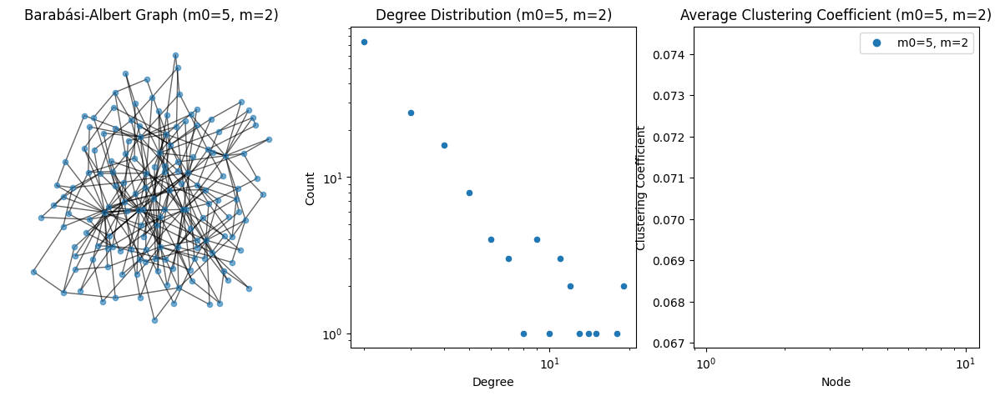

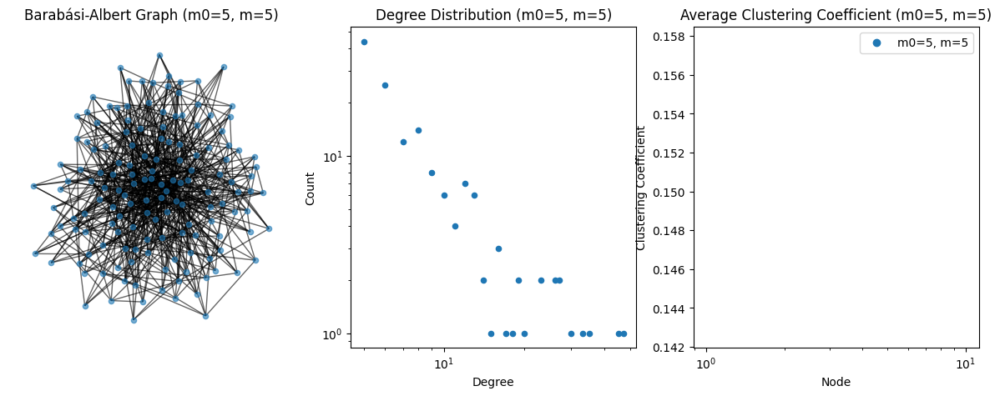

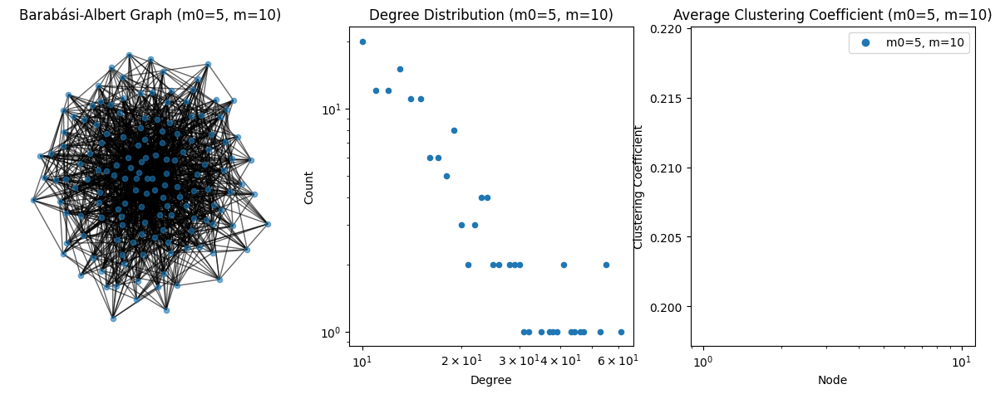

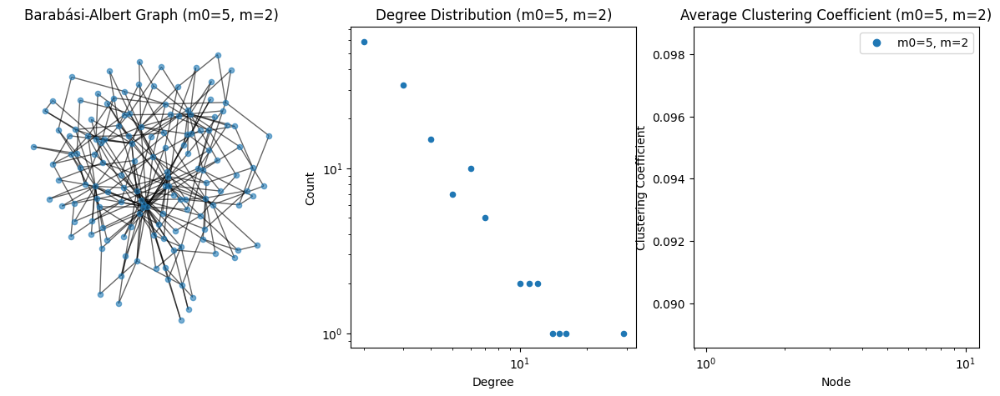

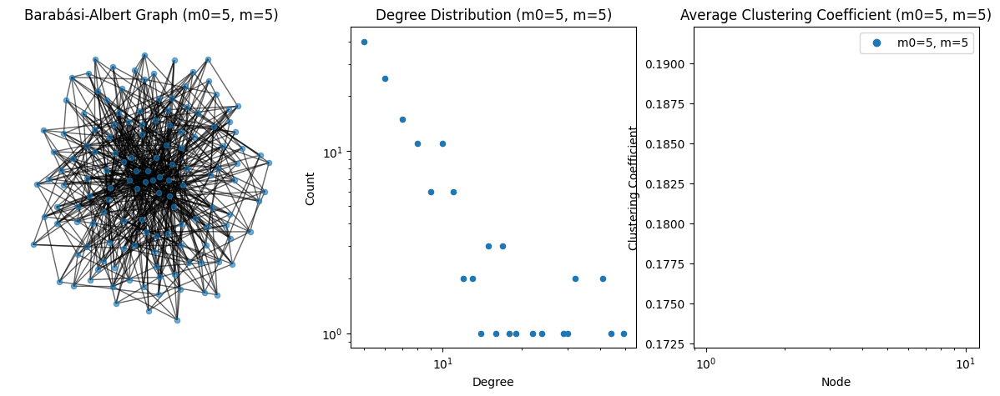

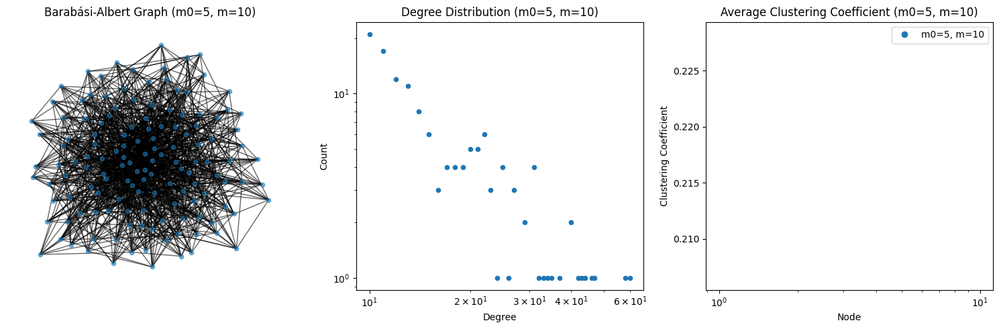

In [6]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Function to generate Barabási-Albert graphs and plot structures
def generate_barabasi_albert_graph(num_nodes, m0, m):
    # Generate the graph using the Barabási-Albert model
    graph = nx.barabasi_albert_graph(num_nodes, m)
    
    # Plot the graph structure
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    nx.draw(graph, node_size=20, with_labels=False, font_size=8, alpha=0.6)
    plt.title(f"Barabási-Albert Graph (m0={m0}, m={m})", fontsize=12)

    # Plot the degree distribution
    plt.subplot(132)
    degree_sequence = sorted([d for n, d in graph.degree()], reverse=True)
    degree_count = np.array(np.unique(degree_sequence, return_counts=True)).T
    plt.scatter(degree_count[:, 0], degree_count[:, 1], s=20)
    plt.xscale('log')
    plt.yscale('log')
    plt.title(f"Degree Distribution (m0={m0}, m={m})", fontsize=12)
    plt.xlabel("Degree", fontsize=10)
    plt.ylabel("Count", fontsize=10)

    # Plot the clustering coefficient
    plt.subplot(133)
    avg_clustering_coefficient = nx.average_clustering(graph)
    plt.plot([avg_clustering_coefficient], 'o', label=f'm0={m0}, m={m}')
    plt.xscale('log')
    plt.title(f"Average Clustering Coefficient (m0={m0}, m={m})", fontsize=12)
    plt.xlabel("Node", fontsize=10)
    plt.ylabel("Clustering Coefficient", fontsize=10)
    plt.legend()

    # Plot a single point for the clustering coefficient
    #plt.subplot(133)
    #clustering_coefficient = nx.average_clustering(graph)
    #plt.plot([clustering_coefficient], 'o', label=f'k={k}, p={p}')
    #plt.title("Average Clustering Coefficient", fontsize=12)
    #plt.ylabel("Clustering Coefficient", fontsize=10)
    #plt.legend()

# Assuming you have loaded your Facebook-Ego and Twitter-Ego networks
# facebook_network = ...
# twitter_network = ...

# Set the number of nodes in each graph
facebook_n = len(facebook_network.nodes())
twitter_n = len(twitter_network.nodes())

# Generate Barabási-Albert graphs for Facebook-Ego network
generate_barabasi_albert_graph(facebook_n, 5, 2)
generate_barabasi_albert_graph(facebook_n, 5, 5)
generate_barabasi_albert_graph(facebook_n, 5, 10)

# Generate Barabási-Albert graphs for Twitter-Ego network
generate_barabasi_albert_graph(twitter_n, 5, 2)
generate_barabasi_albert_graph(twitter_n, 5, 5)
generate_barabasi_albert_graph(twitter_n, 5, 10)

plt.tight_layout()
plt.show()

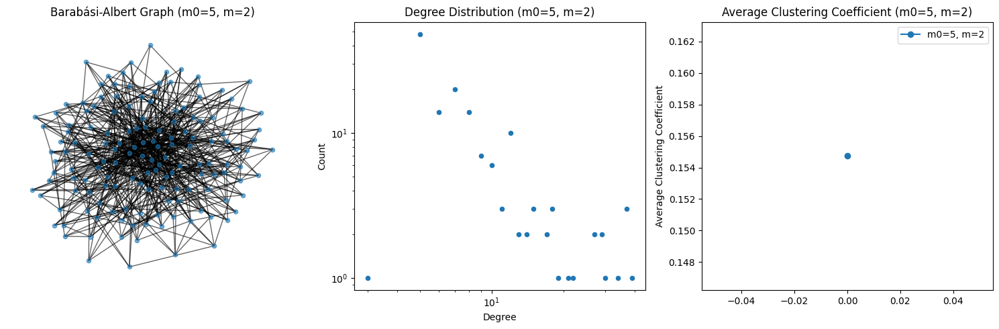

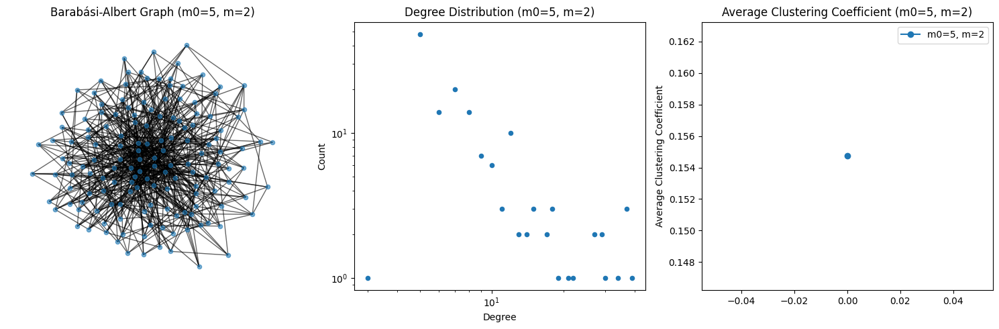

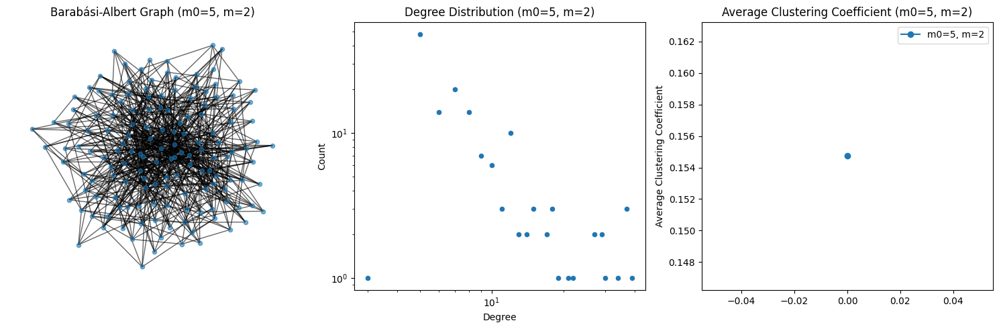

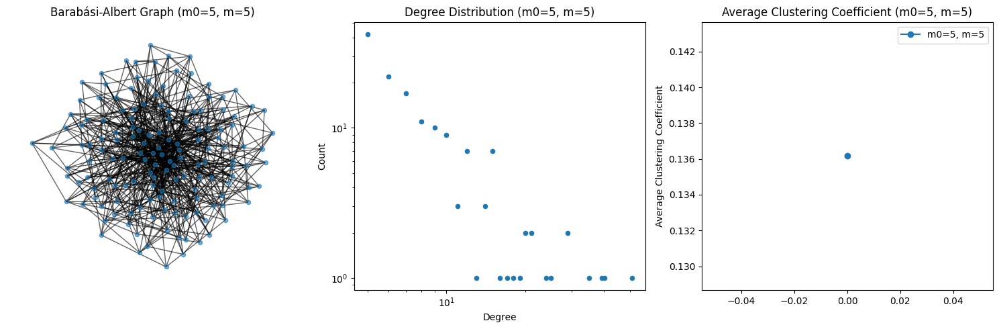

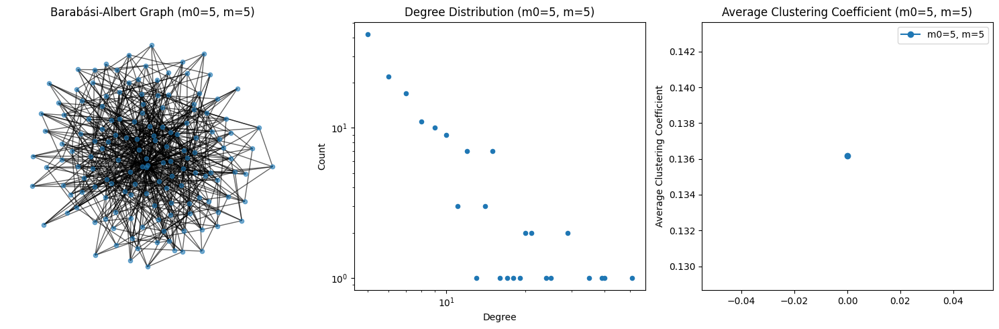

...

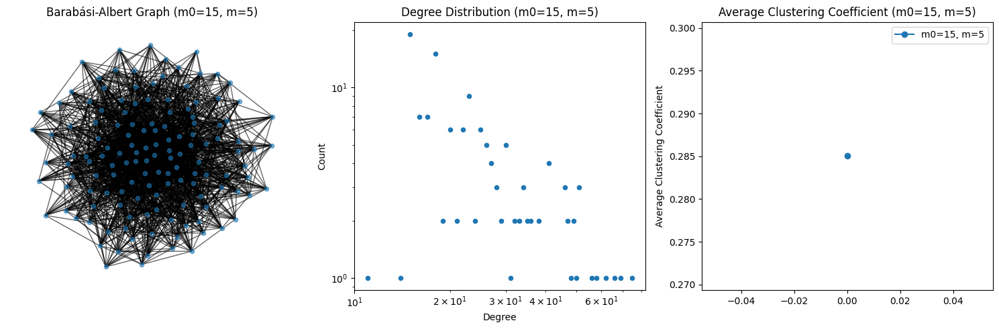

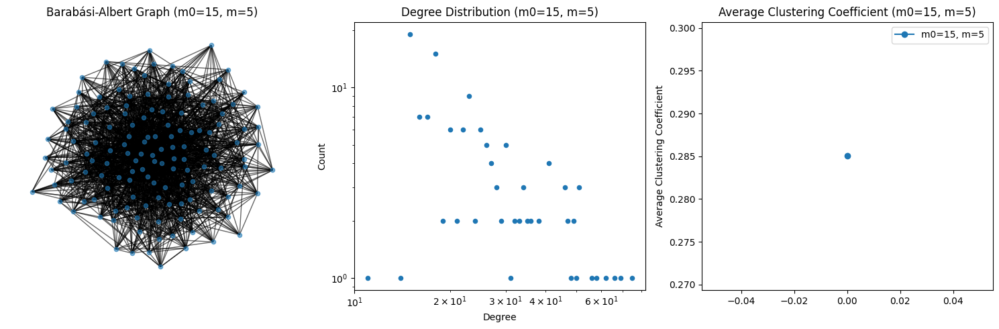

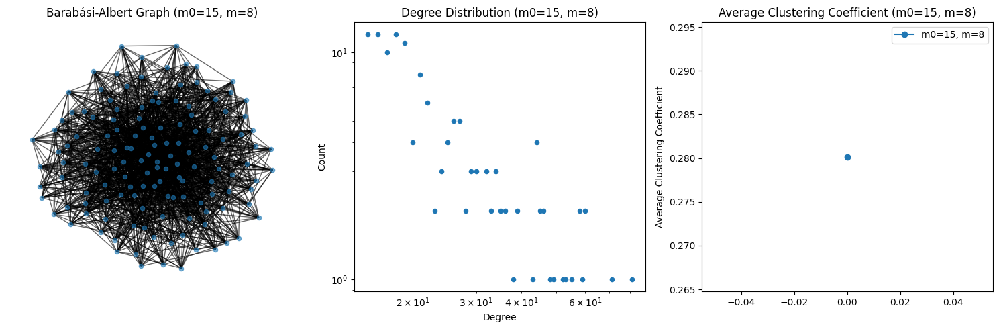

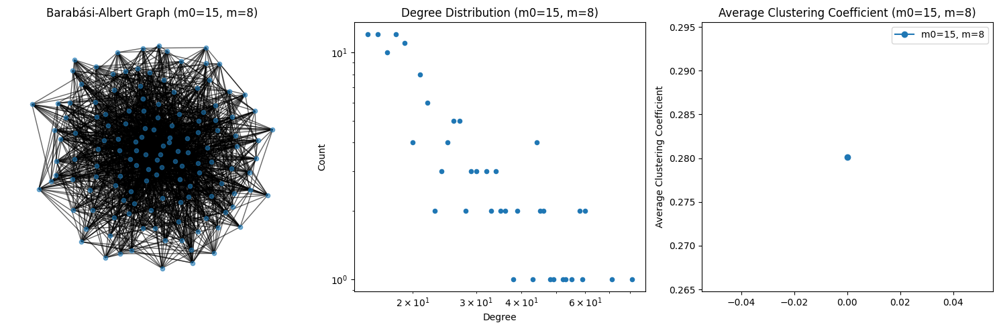

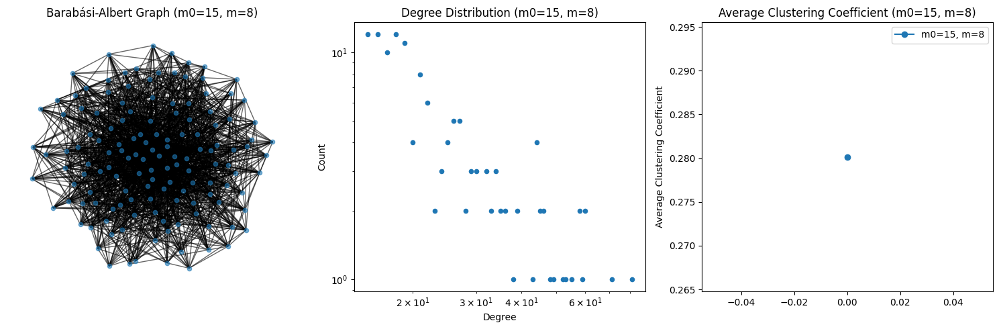

In [24]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt

# Function to generate Barabási-Albert graphs and plot structures
def generate_barabasi_albert_graphs(num_nodes, m0_values, m_values, num_graphs_per_setting):
    for m0 in m0_values:
        for m in m_values:
            avg_clustering_coeffs = []  # To store average clustering coefficients for each graph
            for _ in range(num_graphs_per_setting):
                # Generate the graph using the Barabási-Albert model
                graph = nx.barabasi_albert_graph(num_nodes, m0, m)
                
                # Plot the graph structure
                plt.figure(figsize=(15, 5))
                plt.subplot(131)
                nx.draw(graph, node_size=20, with_labels=False, font_size=8, alpha=0.6)
                plt.title(f"Barabási-Albert Graph (m0={m0}, m={m})", fontsize=12)

                # Plot the degree distribution
                plt.subplot(132)
                degree_sequence = sorted([d for n, d in graph.degree()], reverse=True)
                degree_count = np.array(np.unique(degree_sequence, return_counts=True)).T
                plt.scatter(degree_count[:, 0], degree_count[:, 1], s=20)
                plt.xscale('log')
                plt.yscale('log')
                plt.title(f"Degree Distribution (m0={m0}, m={m})", fontsize=12)
                plt.xlabel("Degree", fontsize=10)
                plt.ylabel("Count", fontsize=10)

                # Plot the average clustering coefficient
                avg_clustering_coefficient = nx.average_clustering(graph)
                avg_clustering_coeffs.append(avg_clustering_coefficient)
                
                plt.subplot(133)
                plt.plot([avg_clustering_coefficient], 'o-', label=f'm0={m0}, m={m}')
                plt.title(f"Average Clustering Coefficient (m0={m0}, m={m})", fontsize=12)
                plt.ylabel("Average Clustering Coefficient", fontsize=10)
                plt.legend()

                plt.tight_layout()
                plt.show()

            

# Assuming you have loaded your Facebook-Ego and Twitter-Ego networks
# facebook_network = ...
# twitter_network = ...

# Set the number of nodes in each graph
facebook_n = len(facebook_network.nodes())
twitter_n = len(twitter_network.nodes())

# Generate Barabási-Albert graphs for Facebook-Ego network
generate_barabasi_albert_graphs(facebook_n, [5, 10, 15], [2, 5, 8], num_graphs_per_setting=3)

# Generate Barabási-Albert graphs for Twitter-Ego network
generate_barabasi_albert_graphs(twitter_n, [5, 10, 15], [2, 5, 8], num_graphs_per_setting=3)
